<a href="https://colab.research.google.com/github/Andreagazy/PCVK-2024/blob/main/Week3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import numpy as np
import pandas as pd
import cv2 as cv
from google.colab.patches import cv2_imshow
from skimage import io
from skimage import transform
from PIL import Image
import matplotlib.pylab as plt

Mengubah tingkat kecerahan citra
--------------------------------
Masukkan nilai kecerahan: 100


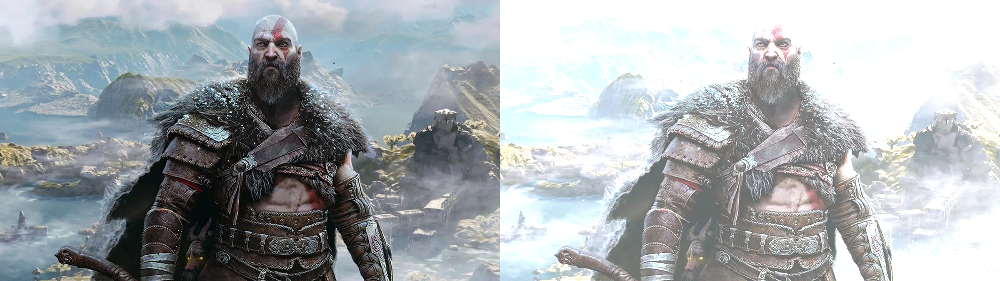

In [3]:
print('Mengubah tingkat kecerahan citra')
print('--------------------------------')
try:
  brightness = int(input('Masukkan nilai kecerahan: '))
except ValueError:
  print('Error, not a number')

ori = cv.imread('/content/drive/MyDrive/PCVK/Real_Kratos.jpg')
brightness_img = np.zeros(ori.shape, ori.dtype)

# Akses per pixel
# for y in range(ori.shape[0]):
#   for x in range(ori.shape[1]):
#     for c in range(ori.shape[2]):
#       brightness_img[y,x,c] = np.clip(ori[y,x,c]+brightness,0,255) # formula g(x)=f(x)+b

# Cara simple tanpa loop
brightness_img = cv.convertScaleAbs(ori, beta=brightness)

final_frame = cv.hconcat((ori, brightness_img))
cv2_imshow(final_frame)

## Tugas

Mengubah citra menjadi negatif (inverse)
---------------------------------------


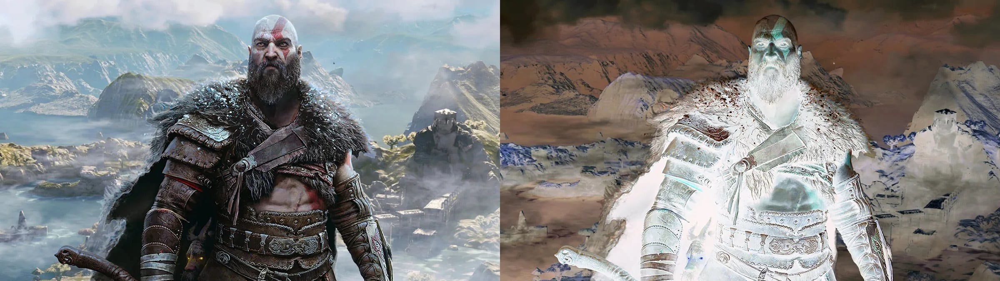

In [6]:
print('Mengubah citra menjadi negatif (inverse)')
print('---------------------------------------')
original = cv.imread('/content/drive/MyDrive/PCVK/Real_Kratos.jpg')
inverse = cv.bitwise_not(original)

final_frame = cv.hconcat((original, inverse))
cv2_imshow(final_frame)

Mengubah kontras dan tingkat kecerahan citra
---------------------------------
Masukkan nilai kecerahan [-255 hingga 255]: 100
Masukkan nilai kontras [1.0 hingga 3.0 ]2


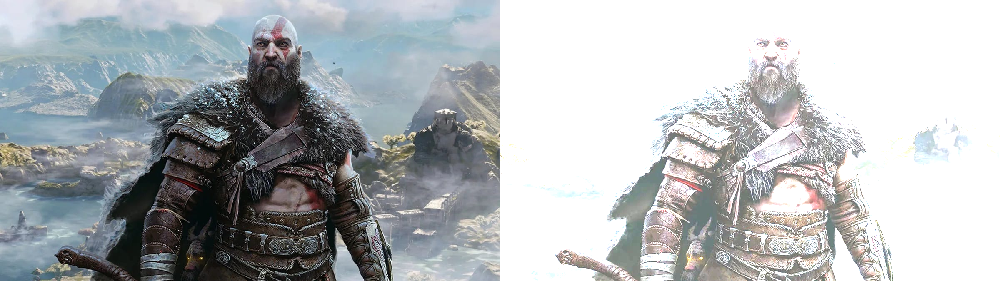

In [7]:
print('Mengubah kontras dan tingkat kecerahan citra')
print('---------------------------------')

img = cv.imread('/content/drive/MyDrive/PCVK/Real_Kratos.jpg')
try:
  brightness = int(input('Masukkan nilai kecerahan [-255 hingga 255]: '))
  contrast = float(input('Masukkan nilai kontras [1.0 hingga 3.0 ]'))
except ValueError:
    print('Error, not a number')

contrast_img = np.zeros(img.shape, img.dtype)

for y in range(img.shape[0]):
  for x in range(img.shape[1]):
    for c in range(img.shape[2]):
      contrast_img[y,x,c] = np.clip(contrast*img[y,x,c]+brightness,0,255)

final_frame = cv.hconcat((img, contrast_img))
cv2_imshow(final_frame)


Mengubah tingkat kecerahan cintra dengan Transformasi Log
---------------------------------
Masukkan nilai kecerahan: 10


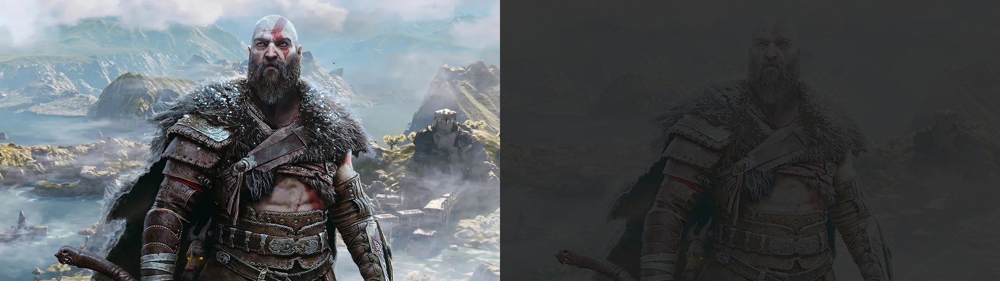

In [13]:
print('Mengubah tingkat kecerahan cintra dengan Transformasi Log')
print('---------------------------------')

img = cv.imread('/content/drive/MyDrive/PCVK/Real_Kratos.jpg')
try:
  brightness = int(input('Masukkan nilai kecerahan: '))
except ValueError:
  print('Error, not a number')

log_transformation_img = np.zeros(img.shape, img.dtype)


for y in range(img.shape[0]):
  for x in range(img.shape[1]):
    for c in range(img.shape[2]):
      # r = img[y,x,c]
      log_transformation_img[y,x,c] = np.clip(brightness*np.log(1+img[y,x,c]),0,255)

final_frame = cv.hconcat((img, log_transformation_img))
cv2_imshow(final_frame)


**Grayscale Averaging**

Grayscale Average
--------------------------------------------------------


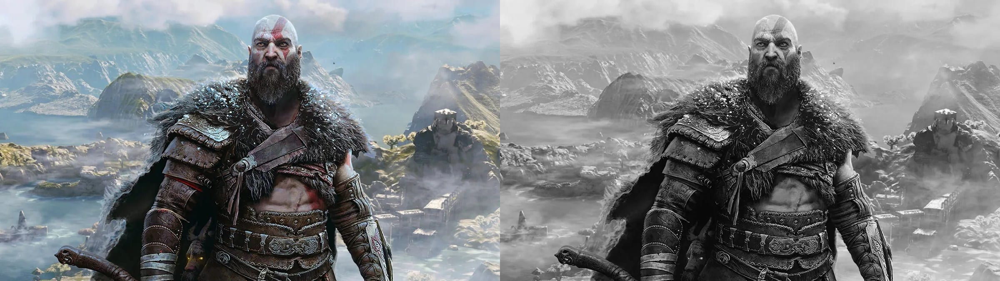

In [14]:
print('Grayscale Average')
print('--------------------------------------------------------')

img = cv.imread('/content/drive/MyDrive/PCVK/Real_Kratos.jpg')
gs_avg_img = np.zeros(img.shape, img.dtype)

for y in range(img.shape[0]):
  for x in range(img.shape[1]):
    gs_avg_img[y,x] = np.mean(img[y,x])

final_frame = cv.hconcat((img, gs_avg_img))
cv2_imshow(final_frame)


**Grayscale Lightness**


Grayscale Lightness
--------------------------------------------------------


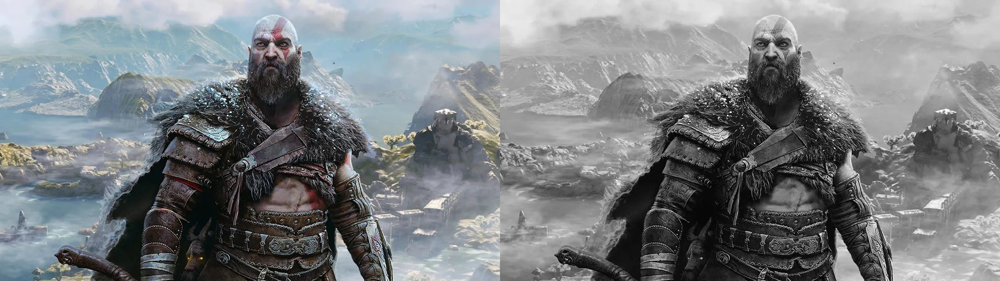

In [16]:
print('Grayscale Lightness')
print('--------------------------------------------------------')

img = cv.imread('/content/drive/MyDrive/PCVK/Real_Kratos.jpg')
gs_lightness_img = np.zeros(img.shape, img.dtype)

for y in range(img.shape[0]):
  for x in range(img.shape[1]):
    gs_lightness_img[y,x] = np.mean([np.max(img[y, x]), np.min(img[y, x])])

final_frame = cv.hconcat((img, gs_lightness_img))
cv2_imshow(final_frame)

**Grayscale Luminance**

Grayscale Luminance
--------------------------------------------------------


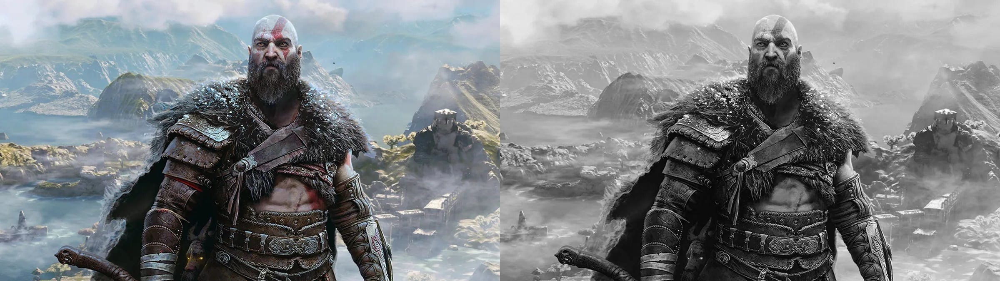

In [17]:
print('Grayscale Luminance')
print('--------------------------------------------------------')

img = cv.imread('/content/drive/MyDrive/PCVK/Real_Kratos.jpg')
gs_luminance_img = np.zeros(img.shape, img.dtype)

for y in range(img.shape[0]):
  for x in range(img.shape[1]):
    gs_luminance_img[y,x] = int(0.21 * img[y, x][0] + 0.72 * img[y, x][1] + 0.07 * img[y, x][2])


final_frame = cv.hconcat((img, gs_luminance_img))
cv2_imshow(final_frame)

**Grayscale**

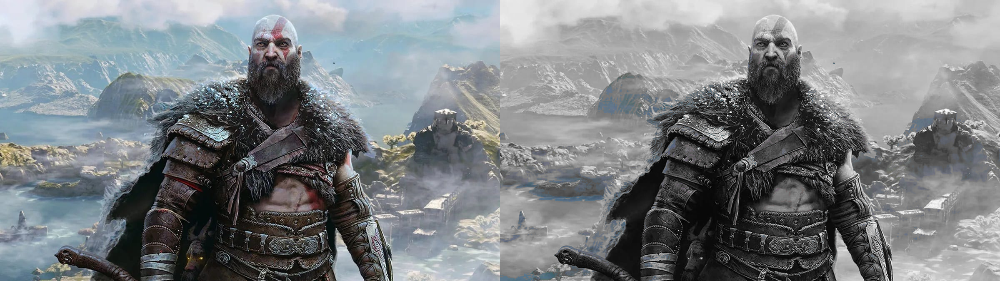

In [20]:
img = cv.imread('/content/drive/MyDrive/PCVK/Real_Kratos.jpg')

result_img = np.zeros(img.shape, img.dtype)

for y in range(img.shape[0]):
    for x in range(img.shape[1]):
        B, G, R = img[y, x]
        if B > 100 and G < 120 and R < 120:

            result_img[y, x] = img[y, x]
        else:

            gray = np.mean([B, G, R])
            result_img[y, x] = [gray, gray, gray]

final_frame = cv.hconcat((img, result_img))
cv2_imshow(final_frame)